## **Classification ML Model  **
# 28/7/2025

In [1]:
# importing necessary liabraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import RobustScaler,MinMaxScaler,LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
 

In [2]:
import pandas as pd 
url = 'https://raw.githubusercontent.com/vaibhavi541/BankChurn_PredictionModel/refs/heads/main/Customer-Churn-Records.csv'

df = pd.read_csv(url)
df.head()


,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Complain,Satisfaction Score,Card Type,Point Earned
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1,1,2,DIAMOND,464
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0,1,3,DIAMOND,456
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1,1,3,DIAMOND,377
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0,0,5,GOLD,350
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0,0,5,GOLD,425


In [3]:
# checking information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 18 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   RowNumber           10000 non-null  int64  
 1   CustomerId          10000 non-null  int64  
 2   Surname             10000 non-null  object 
 3   CreditScore         10000 non-null  int64  
 4   Geography           10000 non-null  object 
 5   Gender              10000 non-null  object 
 6   Age                 10000 non-null  int64  
 7   Tenure              10000 non-null  int64  
 8   Balance             10000 non-null  float64
 9   NumOfProducts       10000 non-null  int64  
 10  HasCrCard           10000 non-null  int64  
 11  IsActiveMember      10000 non-null  int64  
 12  EstimatedSalary     10000 non-null  float64
 13  Exited              10000 non-null  int64  
 14  Complain            10000 non-null  int64  
 15  Satisfaction Score  10000 non-null  int64  
 16  Card 

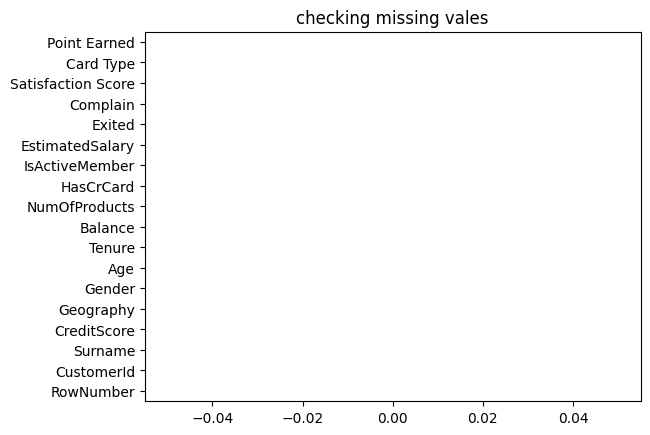

In [4]:
# checking null values in dataset
Data_info=df.isnull().sum()/ len(df)*100 # we create object data_info and give ans in % of missing value
Data_info.plot(kind='barh')
plt.title('checking missing vales')
plt.show()

In [5]:
#segregate columns
categorical_col = df.select_dtypes(include = 'object')
numerical_col = df.select_dtypes(exclude='object')
categorical_col

,Surname,Geography,Gender,Card Type
0,Hargrave,France,Female,DIAMOND
1,Hill,Spain,Female,DIAMOND
2,Onio,France,Female,DIAMOND
3,Boni,France,Female,GOLD
4,Mitchell,Spain,Female,GOLD
...,...,...,...,...
9995,Obijiaku,France,Male,DIAMOND
9996,Johnstone,France,Male,PLATINUM
9997,Liu,France,Female,SILVER
9998,Sabbatini,Germany,Male,GOLD


In [6]:
# EDA : univariate analysis
from collections import OrderedDict
stats = []

for i in numerical_col.columns:
    numerical_stats = OrderedDict({
        'feature': i,
       
        'Min':df[i].min(),
        'Mean':df[i].mean(),
        'median':df[i].median(),
        'Max':df[i].max(),
        'Q1': df[i].quantile(0.25),
        'Q3':df[i].quantile(0.75),
        'IQR':df[i].quantile(0.75)-df[i].quantile(0.25),
        'StandardDeviatin': df[i].std(),
        'skewness': df[i].skew(),
        'Kurtosis':df[i].kurt()

    })
    stats.append(numerical_stats)
    report =pd.DataFrame(stats)
report

,feature,Min,Mean,median,Max,Q1,Q3,IQR,StandardDeviatin,skewness,Kurtosis
0,RowNumber,1.00,5.000500e+03,5.000500e+03,10000.00,2500.75,7.500250e+03,4999.5000,2886.895680,0.000000,-1.200000
1,CustomerId,15565701.00,1.569094e+07,1.569074e+07,15815690.00,15628528.25,1.575323e+07,124705.5000,71936.186123,0.001149,-1.196113
2,CreditScore,350.00,6.505288e+02,6.520000e+02,850.00,584.00,7.180000e+02,134.0000,96.653299,-0.071607,-0.425726
3,Age,18.00,3.892180e+01,3.700000e+01,92.00,32.00,4.400000e+01,12.0000,10.487806,1.011320,1.395347
4,Tenure,0.00,5.012800e+00,5.000000e+00,10.00,3.00,7.000000e+00,4.0000,2.892174,0.010991,-1.165225
5,Balance,0.00,7.648589e+04,9.719854e+04,250898.09,0.00,1.276442e+05,127644.2400,62397.405202,-0.141109,-1.489412
6,NumOfProducts,1.00,1.530200e+00,1.000000e+00,4.00,1.00,2.000000e+00,1.0000,0.581654,0.745568,0.582981
7,HasCrCard,0.00,7.055000e-01,1.000000e+00,1.00,0.00,1.000000e+00,1.0000,0.455840,-0.901812,-1.186973
8,IsActiveMember,0.00,5.151000e-01,1.000000e+00,1.00,0.00,1.000000e+00,1.0000,0.499797,-0.060437,-1.996747
9,EstimatedSalary,11.58,1.000902e+05,1.001939e+05,199992.48,51002.11,1.493882e+05,98386.1375,57510.492818,0.002085,-1.181518


In [7]:
#CrossTab : use for showing  column wise or statistical analysis. like age wise exited bank data 
# view in full view form data

pd.set_option('display.max_rows',None)
crosstab = pd.crosstab(columns=[df.Age,df.IsActiveMember],index=[df.Exited])
crosstab # T means transform data in rows to column
# result is age wise exited and is active member in this bank 


Age            18      19      20      21      22      ... 79 80 81 82 83 84  \
IsActiveMember  0   1   0   1   0   1   0   1   0   1  ...  1  1  1  1  1  0   
Exited                                                 ...                     
0               9  11  12  14  19  19  20  30  30  42  ...  4  3  4  1  1  0   
1               0   2   0   1   2   0   1   2   8   4  ...  0  0  0  0  0  1   

Age               85 88 92  
IsActiveMember  1  1  1  1  
Exited                      
0               1  1  1  2  
1               0  0  0  0  

[2 rows x 131 columns]

In [8]:
# check the target colum values
df['Exited'].value_counts()

Exited
0    7962
1    2038
Name: count, dtype: int64

In [9]:
# Segregate information of churn people  i.e 2038 
df[df['Exited']== 1]


,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Complain,Satisfaction Score,Card Type,Point Earned
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1,1,2,DIAMOND,464
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1,1,3,DIAMOND,377
5,6,15574012,Chu,645,Spain,Male,44,8,113755.78,2,1,0,149756.71,1,1,5,DIAMOND,484
7,8,15656148,Obinna,376,Germany,Female,29,4,115046.74,4,1,0,119346.88,1,1,2,DIAMOND,282
16,17,15737452,Romeo,653,Germany,Male,58,1,132602.88,1,1,0,5097.67,1,0,2,SILVER,163
22,23,15699309,Gerasimov,510,Spain,Female,38,4,0.00,1,1,0,118913.53,1,1,2,DIAMOND,887
30,31,15589475,Azikiwe,591,Spain,Female,39,3,0.00,3,1,0,140469.38,1,1,3,DIAMOND,298
35,36,15794171,Lombardo,475,France,Female,45,0,134264.04,1,1,0,27822.99,1,1,1,DIAMOND,877
41,42,15738148,Clarke,465,France,Female,51,8,122522.32,1,0,0,181297.65,1,1,5,SILVER,828
43,44,15755196,Lavine,834,France,Female,49,2,131394.56,1,0,0,194365.76,1,1,2,GOLD,567


In [10]:
df[df['Exited']== 1]['Age']

0       42
2       42
5       44
7       29
16      58
22      38
30      39
35      45
41      51
43      49
46      27
47      39
53      41
54      42
58      66
70      58
81      32
86      22
88      46
90      44
104     65
105     46
109     35
114     28
118     31
125     42
126     52
127     56
138     48
139     35
143     52
144     31
151     48
155     57
164     29
166     24
168     39
172     44
179     55
184     50
190     41
202     50
203     38
206     41
208     45
215     47
218     43
219     54
223     33
224     45
227     39
228     50
235     42
237     43
238     46
243     67
245     40
249     54
268     39
271     34
276     62
279     46
282     35
293     34
297     44
306     43
308     50
316     49
322     40
327     46
333     30
335     29
338     39
339     39
340     40
357     34
361     45
376     45
379     39
392     46
393     38
399     66
406     49
413     41
416     61
420     60
422     40
429     40
430     57
433     37
444     47

## **Balancing Technique for model **

In [11]:
# showing columns in dataset
df.columns

Index(['RowNumber', 'CustomerId', 'Surname', 'CreditScore', 'Geography',
       'Gender', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'HasCrCard',
       'IsActiveMember', 'EstimatedSalary', 'Exited', 'Complain',
       'Satisfaction Score', 'Card Type', 'Point Earned'],
      dtype='object')

In [12]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

for i in categorical_col.columns:
    df[i]=le.fit_transform(df[i])
df

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Complain,Satisfaction Score,Card Type,Point Earned
0,1,15634602,1115,619,0,0,42,2,0.00,1,1,1,101348.88,1,1,2,0,464
1,2,15647311,1177,608,2,0,41,1,83807.86,1,0,1,112542.58,0,1,3,0,456
2,3,15619304,2040,502,0,0,42,8,159660.80,3,1,0,113931.57,1,1,3,0,377
3,4,15701354,289,699,0,0,39,1,0.00,2,0,0,93826.63,0,0,5,1,350
4,5,15737888,1822,850,2,0,43,2,125510.82,1,1,1,79084.10,0,0,5,1,425
5,6,15574012,537,645,2,1,44,8,113755.78,2,1,0,149756.71,1,1,5,0,484
6,7,15592531,177,822,0,1,50,7,0.00,2,1,1,10062.80,0,0,2,3,206
7,8,15656148,2000,376,1,0,29,4,115046.74,4,1,0,119346.88,1,1,2,0,282
8,9,15792365,1146,501,0,1,44,4,142051.07,2,0,1,74940.50,0,0,3,1,251
9,10,15592389,1081,684,0,1,27,2,134603.88,1,1,1,71725.73,0,0,3,1,342


In [13]:
df = df.drop(columns=['RowNumber', 'CustomerId', 'Surname'])
df

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Complain,Satisfaction Score,Card Type,Point Earned
0,619,0,0,42,2,0.00,1,1,1,101348.88,1,1,2,0,464
1,608,2,0,41,1,83807.86,1,0,1,112542.58,0,1,3,0,456
2,502,0,0,42,8,159660.80,3,1,0,113931.57,1,1,3,0,377
3,699,0,0,39,1,0.00,2,0,0,93826.63,0,0,5,1,350
4,850,2,0,43,2,125510.82,1,1,1,79084.10,0,0,5,1,425
5,645,2,1,44,8,113755.78,2,1,0,149756.71,1,1,5,0,484
6,822,0,1,50,7,0.00,2,1,1,10062.80,0,0,2,3,206
7,376,1,0,29,4,115046.74,4,1,0,119346.88,1,1,2,0,282
8,501,0,1,44,4,142051.07,2,0,1,74940.50,0,0,3,1,251
9,684,0,1,27,2,134603.88,1,1,1,71725.73,0,0,3,1,342


In [14]:
df.shape

(10000, 15)

In [15]:

# split data X and y
X = df.drop(columns='Exited', axis=1)
y = df['Exited']

# split train and test data
from sklearn.model_selection import train_test_split

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size = 0.2,
random_state= 42)


In [16]:
# use smote technique for balancing data in target column
''' 
1) whenever solving a classification problem plz ensure data must be balanced 
i.e means target column must be balanced .
2) if target column must not be balanced ,
then model is state to be unstablelized 
(model is not good to good decision)      '''

from imblearn.over_sampling import SMOTE
sm = SMOTE()

X_train,y_train= sm.fit_resample(X_train,y_train)


In [17]:
# Using Robust Scalar for Prevent Model is Overfitting
# scalling technique
from sklearn.preprocessing import RobustScaler
sc = RobustScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [18]:
# predict model accuracy :- use model building
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(n_estimators=100).fit(X_train,y_train)
y_pred_RF = RF.predict(X_test)
accuracy_score(y_test,y_pred_RF)

# preprocessing is must do the carefully to stop overfit data

0.999

In [19]:
# drop the column where IQR = 0 
df.columns

Index(['CreditScore', 'Geography', 'Gender', 'Age', 'Tenure', 'Balance',
       'NumOfProducts', 'HasCrCard', 'IsActiveMember', 'EstimatedSalary',
       'Exited', 'Complain', 'Satisfaction Score', 'Card Type',
       'Point Earned'],
      dtype='object')

In [ ]:
df.shape

(10000, 15)

In [27]:
df = df.drop(columns=['Complain'])
df

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Satisfaction Score,Card Type,Point Earned
0,619,0,0,42,2,0.00,1,1,1,101348.88,1,2,0,464
1,608,2,0,41,1,83807.86,1,0,1,112542.58,0,3,0,456
2,502,0,0,42,8,159660.80,3,1,0,113931.57,1,3,0,377
3,699,0,0,39,1,0.00,2,0,0,93826.63,0,5,1,350
4,850,2,0,43,2,125510.82,1,1,1,79084.10,0,5,1,425
5,645,2,1,44,8,113755.78,2,1,0,149756.71,1,5,0,484
6,822,0,1,50,7,0.00,2,1,1,10062.80,0,2,3,206
7,376,1,0,29,4,115046.74,4,1,0,119346.88,1,2,0,282
8,501,0,1,44,4,142051.07,2,0,1,74940.50,0,3,1,251
9,684,0,1,27,2,134603.88,1,1,1,71725.73,0,3,1,342


In [28]:
# 31/7/2025 use Logistic regression  
from sklearn.linear_model import LogisticRegression
LR = LogisticRegression().fit(X_train,y_train)
y_pred_LR = LR.predict(X_test)
accuracy_score(y_test,y_pred_LR)

0.999

In [29]:

from sklearn.ensemble import AdaBoostClassifier #learning rate = 1
ada = AdaBoostClassifier().fit(X_train,y_train)
y_pred_ada = ada.predict(X_test)
accuracy_score(y_test,y_pred_ada)


0.999

In [30]:
from sklearn.ensemble import GradientBoostingClassifier #learning rate = 0.1
GR = GradientBoostingClassifier().fit(X_train,y_train)
y_pred_GR = GR.predict(X_test)
accuracy_score(y_test,y_pred_GR)

0.999

In [ ]:
# Deep Learning Steps for checking model is good or not 

import tensorflow as tf 
from keras.models import Sequential
from keras.layers import Dense

model = Sequential()
model.add(Dense(units = 100,activation = 'relu', input_dim = X_train.shape[1]))
model.add(Dense(units = 50,activation = 'relu')) #Dense is used to ANN
model.add(Dense(units = 25,activation = 'relu')) # for image is 2D convo2D replace
model.add(Dense(units = 12,activation = 'relu'))
model.add(Dense(units = 6,activation = 'relu'))
model.add(Dense(units = 3,activation = 'relu'))
model.add(Dense(units = 1,activation = 'sigmoid')) # only last column is output

model.compile(optimizer='adam', loss='binary_crossentropy',metrics = ['accuracy'])

history = model.fit(X_train , y_train,epochs = 100,batch_size = 32,
validation_data =(X_test,y_test))


Epoch 1/100


Text(0, 0.5, 'Epoch')

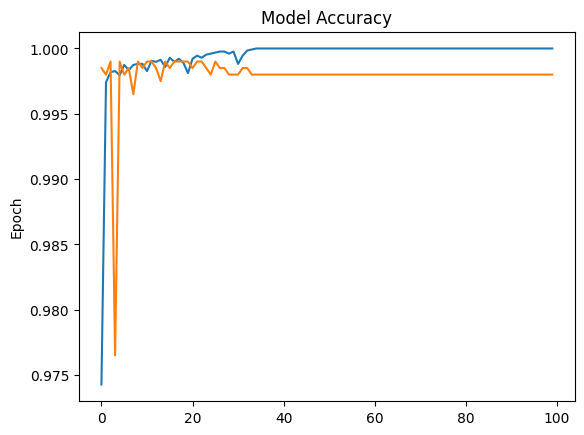

In [25]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Epoch')